<a href="https://colab.research.google.com/github/amisq987/OLIST/blob/main/OLIST_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import os
import seaborn as sns
from matplotlib import pyplot as plt
plt.style.use('ggplot')
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.dates as mdates
import plotly.graph_objects as go
from datetime import datetime
!pip install squarify
import squarify
from scipy.stats import mannwhitneyu

In [2]:
 df = pd.read_csv('/content/drive/MyDrive/archive/olist_cleaned.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115608 entries, 0 to 115607
Data columns (total 45 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       115608 non-null  object 
 1   customer_id                    115608 non-null  object 
 2   order_status                   115608 non-null  object 
 3   order_purchase_timestamp       115608 non-null  object 
 4   order_approved_at              115608 non-null  object 
 5   order_delivered_carrier_date   115608 non-null  object 
 6   order_delivered_customer_date  115608 non-null  object 
 7   order_estimated_delivery_date  115608 non-null  object 
 8   order_item_id                  115608 non-null  int64  
 9   product_id                     115608 non-null  object 
 10  seller_id                      115608 non-null  object 
 11  shipping_limit_date            115608 non-null  object 
 12  price                         

In [9]:
date_cols = [
         "order_purchase_timestamp", "order_approved_at",
         "order_delivered_carrier_date", "order_delivered_customer_date",
         "order_estimated_delivery_date", "review_creation_date"]
df[date_cols] = df[date_cols].apply(pd.to_datetime,errors='coerce')

1. Data overview:

In [4]:
df.nunique()

,0
order_id,96515
customer_id,96515
order_status,7
order_purchase_timestamp,95988
order_approved_at,90869
order_delivered_carrier_date,80210
order_delivered_customer_date,95727
order_estimated_delivery_date,449
order_item_id,21
product_id,32170


In [5]:
df['price'].describe()

,price
count,115608.000000
mean,120.619345
std,182.654185
min,0.850000
25%,39.900000
50%,74.900000
75%,134.900000
max,6735.000000


In [6]:
df['payment_value'].describe()

,payment_value
count,115608.000000
mean,172.387192
std,265.875111
min,0.000000
25%,60.870000
50%,108.050000
75%,189.465000
max,13664.080000


In [7]:
df['payment_type'].value_counts()

,count
payment_type,
credit_card,85277
boleto,22510
voucher,6162
debit_card,1659


In [8]:
df['review_score'].value_counts()

,count
review_score,
5,65373
4,21951
1,14546
3,9718
2,4020


In [10]:
print(df['order_purchase_timestamp'].min(), df['order_purchase_timestamp'].max())

2016-09-04 21:15:19 2018-09-03 09:06:57


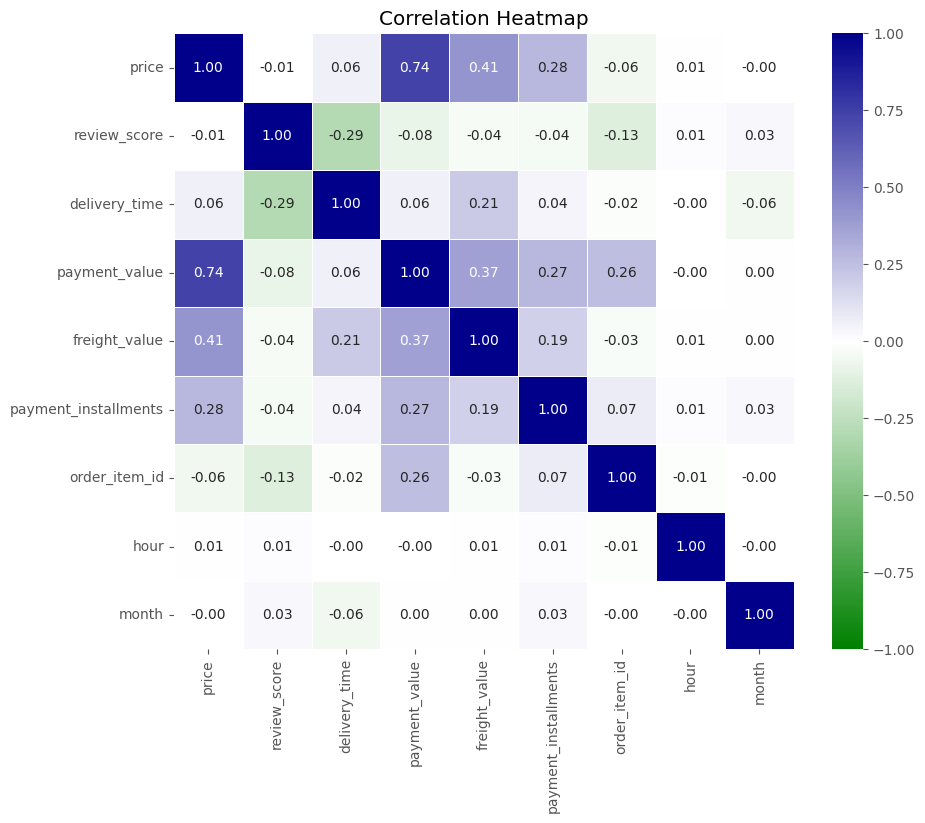

In [20]:
# Select relevant features for correlation analysis
correlation_features = df[['price', 'review_score', 'delivery_time',
                            'payment_value', 'freight_value',
                            'payment_installments', 'order_item_id',
                            'hour', 'month']]

# Calculate the correlation matrix
correlation = correlation_features.corr()

# Define the custom colormap
custom_cmap = LinearSegmentedColormap.from_list("custom_cmap", ['green', 'white', 'darkblue'])

plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap=custom_cmap, vmin=-1, vmax=1, fmt=".2f", linewidths=.5)
plt.title('Correlation Heatmap')
plt.show()

2. Evaluate sales performance and Analyze customer purchasing behavior

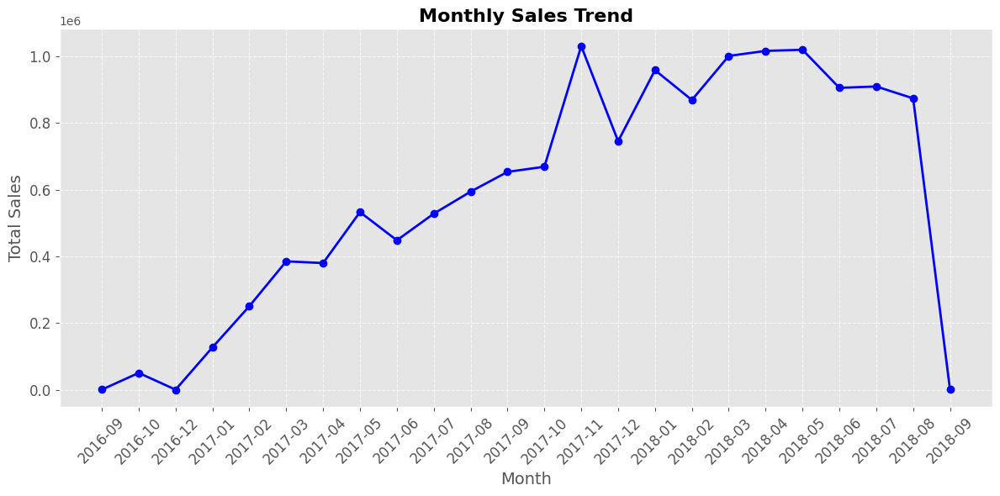

In [13]:
# Monthly sales trend
monthly_sales = df.groupby(df['order_purchase_timestamp'].dt.to_period('M')).agg({'price': 'sum'})

# Set the figure size for better visibility
plt.figure(figsize=(12, 6))

# Plot the data with custom colors
plt.plot(monthly_sales.index.astype(str), monthly_sales['price'],
         marker='o', linestyle='-', color='blue', linewidth=2)

# Adding titles and labels
plt.title('Monthly Sales Trend', fontsize=16, fontweight='bold')
plt.xlabel('Month', fontsize=14)
plt.ylabel('Total Sales', fontsize=14)

# Customize the ticks
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)

# Add gridlines for better readability
plt.grid(visible=True, linestyle='--', alpha=0.7)

# Show the plot
plt.tight_layout()
plt.show()

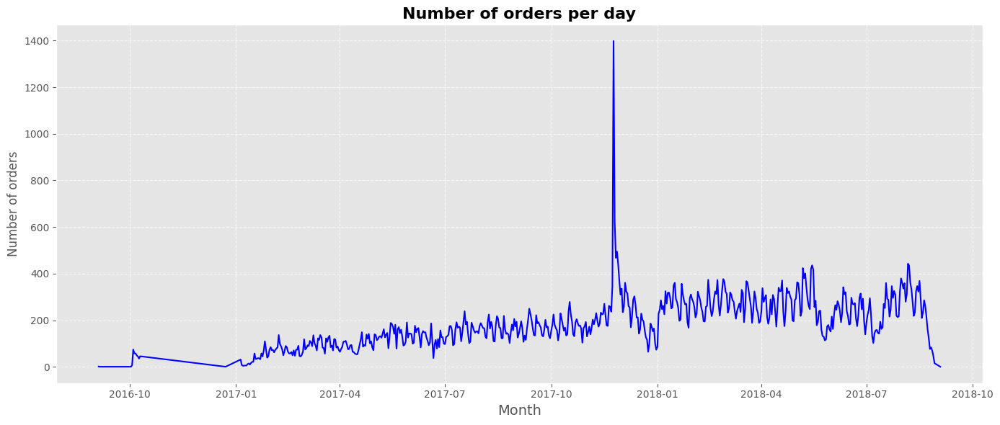

In [14]:
# Group by timestamp and aggregate order counts
daily_orders = df.groupby(df['order_purchase_timestamp'].dt.floor('D'))['order_id'].count().reset_index()

# Convert 'order_purchase_timestamp' to matplotlib dates
dates = mdates.date2num(daily_orders['order_purchase_timestamp'])

# Create the plot
fig, ax = plt.subplots(figsize=(14, 6))
ax.plot(dates, daily_orders['order_id'],color='blue')

# Format x-axis to display dates
date_format = mdates.DateFormatter('%Y-%m')
ax.xaxis.set_major_formatter(date_format)
ax.xaxis_date()

# Set labels and title
plt.ylabel('Number of orders')
plt.title('Number of orders per day', fontsize=16, fontweight='bold')
plt.xlabel('Month', fontsize=14)

# Add grid and show the plot
plt.grid(visible=True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [18]:
# Chuyển day_of_week_int sang tên ngày trong tuần
day_map = {
    1: 'Mon',
    2: 'Tue',
    3: 'Wed',
    4: 'Thu',
    5: 'Fri',
    6: 'Sat',
    7: 'Sun'
}

df['day_of_week_name'] = df['day_of_week_int'].map(day_map)

# Tạo pivot table: đếm số lượng order theo ngày và giờ
pivot_df = df.pivot_table(
    index='day_of_week_name',
    columns='hour',
    values='order_id',
    aggfunc='count',
    fill_value=0
)

# Sắp xếp lại thứ tự ngày cho đúng (Mon -> Sun)
ordered_days = ['Sun', 'Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat']
pivot_df = pivot_df.reindex(ordered_days)

# Hiển thị bảng kết quả
print(pivot_df)

hour               0    1    2   3   4   5    6    7    8     9   ...    14  \
day_of_week_name                                                  ...         
Sun               311  157   87  48  32  26   40  122  245   382  ...   782   
Mon               375  148   74  40  24  28   72  179  561   860  ...  1319   
Tue               355  176   93  36  28  27   72  256  595  1030  ...  1344   
Wed               493  204  102  40  41  31  105  238  585   964  ...  1255   
Thu               436  200   84  40  49  29   91  258  603   909  ...  1122   
Fri               510  232   78  57  46  40  107  227  594   882  ...  1137   
Sat               355  193   76  50  31  32   74  116  286   486  ...   817   

hour                15    16    17    18    19    20    21    22   23  
day_of_week_name                                                       
Sun                809   804   905  1042  1040  1123   997  1021  701  
Mon               1269  1274  1168  1106  1108  1160  1255  1186  841  


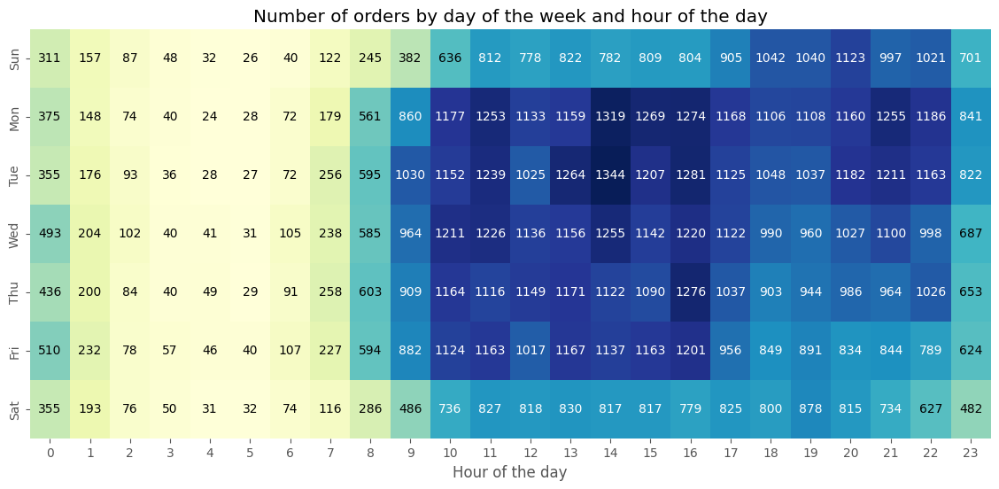

In [19]:
fig, ax = plt.subplots(figsize=(14, 6))
sns.heatmap(pivot_df, cmap='YlGnBu', cbar=False)
mean_orders = pivot_df.mean().mean()
for i in range(len(pivot_df)):
    for j in range(len(pivot_df.columns)):
        text_color = 'white' if pivot_df.iloc[i, j] > mean_orders else 'black'
        ax.text(j+0.5, i+0.5, int(pivot_df.iloc[i, j]),
            color=text_color, fontsize=10, ha="center", va="center")
plt.title("Number of orders by day of the week and hour of the day")
plt.xlabel("Hour of the day")
plt.ylabel("")
plt.show()

In [15]:
df['order_price'] = df['price'] + df['freight_value']

# Group by order_id and sum order_price
order_price_df = df.groupby('order_id')['order_price'].sum().reset_index()

# Aggregate min, avg (rounded), and max
min_order_price = order_price_df['order_price'].min()
avg_order_price = round(order_price_df['order_price'].mean(), 2)
max_order_price = order_price_df['order_price'].max()

# Display results
print("Min Order Price:", min_order_price)
print("Avg Order Price:", avg_order_price)
print("Max Order Price:", max_order_price)

Min Order Price: 10.07
Avg Order Price: 168.51
Max Order Price: 13664.08


In [16]:
delivered_df = df[df['order_status'] == 'delivered']

#Group by 'order_id' and sum 'price' and 'freight_value'
summary_df = delivered_df.groupby('order_id').agg(
    product_cost=('price', 'sum'),
    shipping_cost=('freight_value', 'sum')
).reset_index()

# Display result
print(summary_df)

                               order_id  product_cost  shipping_cost
0      00010242fe8c5a6d1ba2dd792cb16214         58.90          13.29
1      00018f77f2f0320c557190d7a144bdd3        239.90          19.93
2      000229ec398224ef6ca0657da4fc703e        199.00          17.87
3      00024acbcdf0a6daa1e931b038114c75         12.99          12.79
4      00042b26cf59d7ce69dfabb4e55b4fd9        199.90          18.14
...                                 ...           ...            ...
94482  fffc94f6ce00a00581880bf54a75a037        299.99          43.41
94483  fffcd46ef2263f404302a634eb57f7eb        350.00          36.53
94484  fffce4705a9662cd70adb13d4a31832d         99.90          16.95
94485  fffe18544ffabc95dfada21779c9644f         55.99           8.72
94486  fffe41c64501cc87c801fd61db3f6244         43.00          12.79

[94487 rows x 3 columns]


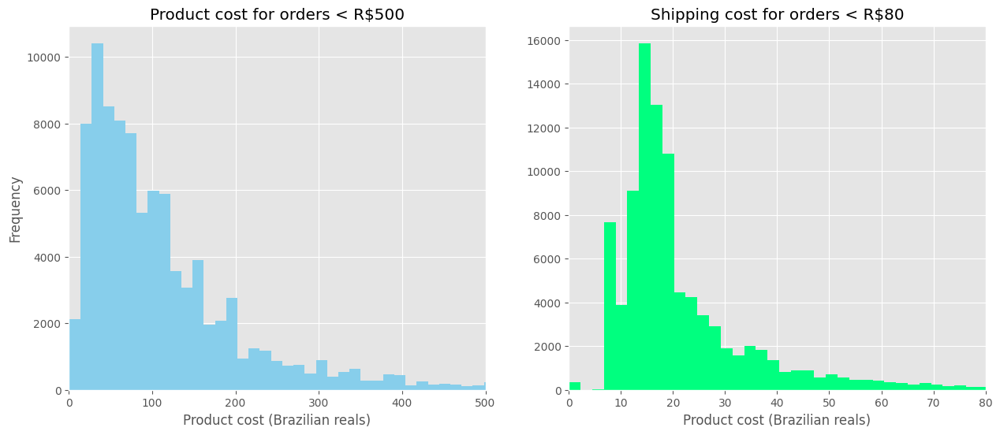

In [17]:
plt.figure(figsize=(15, 6))
# Histogram for total product cost
plt.subplot(1, 2, 1)
plt.hist(summary_df['product_cost'], bins=1000, color='skyblue')
plt.title('Product cost for orders < R$500')
plt.xlabel('Product cost (Brazilian reals)')
plt.ylabel('Frequency')
plt.xlim([0, 500])
# Histogram for total shipping cost
plt.subplot(1, 2, 2)
plt.hist(summary_df['shipping_cost'], bins=800, color='springgreen')
plt.title('Shipping cost for orders < R$80')
plt.xlabel('Product cost (Brazilian reals)')
plt.xlim([0, 80])
plt.show()

In [21]:
payment_type_share = df['payment_type'].value_counts(normalize=True).nlargest(4)
payment_type_share = (payment_type_share*100).round(2)
payment_type_share

,proportion
payment_type,
credit_card,73.76
boleto,19.47
voucher,5.33
debit_card,1.44


In [22]:
df['payment_type'].value_counts()

,count
payment_type,
credit_card,85277
boleto,22510
voucher,6162
debit_card,1659


In [23]:
# Group by payment_type and aggregate
agg_df = df.groupby('payment_type').agg(total_revenue=('payment_value', 'sum'),payment_count=('payment_value', 'count')).reset_index()

# Sort by total_revenue
agg_df = agg_df.sort_values(by='total_revenue')

# Create figure with bar and line traces
fig = go.Figure()

# Bar chart for total_revenue
fig.add_trace(go.Bar(x=agg_df['payment_type'],y=agg_df['total_revenue'],name='Total revenue',marker_color='darkblue'))

# Line chart for payment_count
fig.add_trace(go.Scatter(x=agg_df['payment_type'],y=agg_df['payment_count'],name='Payment count',yaxis='y2',mode='lines+markers',marker=dict(color='dodgerblue', size=8),line=dict(width=3)))

# Layout with dual y-axes
fig.update_layout(title=dict(text='<b>Total revenue and Payment count by Payment type</b>',x=0.5,xanchor='center'),
    xaxis=dict(title='Payment type', showgrid=False),
    yaxis=dict(title='Total revenue', showgrid=False),
    yaxis2=dict(title='Payment count',overlaying='y',side='right'),
    legend=dict(x=0.5, xanchor='center', orientation='h'),
    bargap=0.3,width = 900, height  =700)

fig.show()

In [26]:
installment_ratio = (df['payment_installments'] > 1).mean() * 100
print(f'The proportion of installment orders: {installment_ratio:.2f}%')

The proportion of installment orders: 50.17%


In [25]:
installment_by_category = df.groupby('product_category_name_english')['payment_installments'].apply(lambda x: (x > 1).mean()).nlargest(10)
installment_top_categories = (installment_by_category*100).round()
installment_top_categories

,payment_installments
product_category_name_english,
computers,76.0
la_cuisine,67.0
furniture_mattress_and_upholstery,66.0
small_appliances_home_oven_and_coffee,65.0
watches_gifts,65.0
diapers_and_hygiene,62.0
bed_bath_table,60.0
fashio_female_clothing,60.0
fashion_shoes,60.0


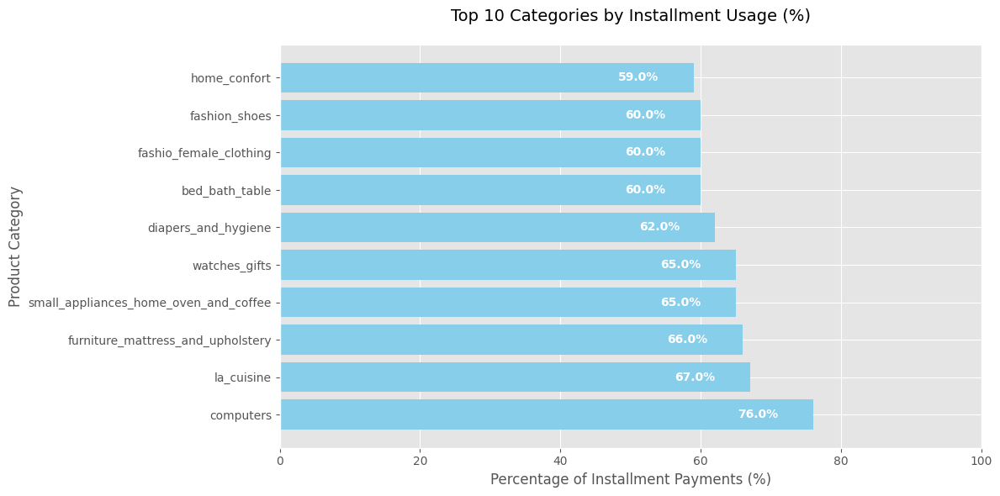

In [27]:
plt.figure(figsize=(12, 6))
bars = plt.barh(installment_top_categories.index, installment_top_categories.values, color='skyblue')
plt.xlabel('Percentage of Installment Payments (%)', fontsize=12)
plt.ylabel('Product Category', fontsize=12)
plt.title('Top 10 Categories by Installment Usage (%)', fontsize=14, pad=20)
plt.xlim(0, 100)
for bar in bars:
    width = bar.get_width()
    plt.text(width - 5, bar.get_y() + bar.get_height()/2,
             f'{width}%',
             ha='right', va='center', color='white', fontweight='bold')
plt.tight_layout()
plt.show()

In [24]:
df['product_category_name_english'].nunique()

71

In [48]:
df = df[df['order_status'] == 'delivered']

# Group by product_category_name_english and calculate sales
category_sales = (
    df.groupby('product_category_name_english_x')['price']
    .sum()
    .reset_index()
    .rename(columns={'price': 'sales'})
)

# Rank by descending sales
category_sales['rank'] = category_sales['sales'].rank(method='dense', ascending=False).astype(int)

# Sort by rank
category_sales = category_sales.sort_values('rank').reset_index(drop=True)

# Rename column for clarity
category_sales = category_sales.rename(columns={'product_category_name_english': 'category'})
print(category_sales)

   product_category_name_english_x       sales  rank
0                    health_beauty  1266992.59     1
1                    watches_gifts  1207633.40     2
2                   bed_bath_table  1082024.32     3
3                   sports_leisure   989602.66     4
4            computers_accessories   922593.78     5
..                             ...         ...   ...
66                         flowers     1000.24    67
67                  home_comfort_2      734.47    68
68               cds_dvds_musicals      730.00    69
69       fashion_childrens_clothes      519.95    70
70           security_and_services      283.29    71

[71 rows x 3 columns]


In [49]:
# Separate top 18 categories
top_18 = category_sales[category_sales['rank'] <= 18]

# Aggregate "Other categories"
others = category_sales[category_sales['rank'] > 18]
others_sum = others['sales'].sum()

# Create a DataFrame for "Other categories"
other_row = pd.DataFrame([{
    'product_category_name_english_x': 'Other categories',
    'sales': others_sum,
    'rank': None  # No rank needed
}])

# Combine both
df_categories = pd.concat([top_18, other_row], ignore_index=True)
print(df_categories)

   product_category_name_english_x       sales  rank
0                    health_beauty  1266992.59     1
1                    watches_gifts  1207633.40     2
2                   bed_bath_table  1082024.32     3
3                   sports_leisure   989602.66     4
4            computers_accessories   922593.78     5
5                  furniture_decor   746811.14     6
6                       housewares   646232.97     7
7                       cool_stuff   628528.54     8
8                             auto   594994.54     9
9                     garden_tools   490451.78    10
10                            toys   483557.04    11
11                            baby   419343.43    12
12                       perfumery   404133.97    13
13                       telephony   323588.44    14
14                office_furniture   277472.70    15
15                      stationery   230955.00    16
16                       computers   229767.62    17
17                        pet_shop   219619.94

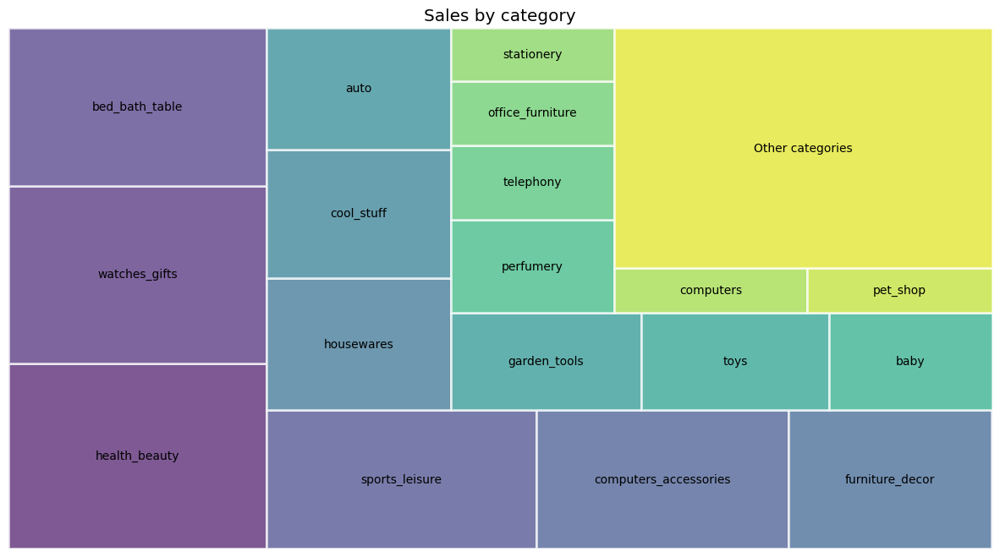

In [50]:
import matplotlib.cm as cm
plt.figure(figsize=(15, 8))
plt.title('Sales by category')
color = sns.color_palette("viridis", len(df_categories))
squarify.plot(sizes=df_categories['sales'], label=df_categories['product_category_name_english_x'],
              alpha=0.7, color=color, edgecolor="white", linewidth=2)
plt.axis('off')
plt.show()

In [52]:
delivered = df[df['order_status'] == 'delivered'].copy()
delivered.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'review_id', 'review_score',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'product_category_name_english_x', 'day_of_week_int',
       'hour', 'month', 'year', 'date', 'delivery_time',
       'geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'orde

In [51]:
palette = sns.color_palette("inferno", 20)
top_palette = palette[-10:]
tail_palette = palette[:10]

def plot_pair(data_top, data_tail, title_top, title_tail, xlabel, ylabel,
              xlim_top=None, xlim_bot=None):
    fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(10, 13), dpi=120,
                           gridspec_kw={'height_ratios': [1, 1], 'hspace': 0.5})

    sns.barplot(x=data_top.values, y=data_top.index, ax=ax[0], palette=top_palette)
    ax[0].set_title(title_top, fontsize=15, weight='bold', pad=15)
    ax[0].set_xlabel('')
    ax[0].set_ylabel(ylabel, labelpad=55, fontsize=13, weight='bold')
    ax[0].spines[['top', 'right']].set_visible(False)
    ax[0].tick_params(axis='y', labelsize=11)
    if xlim_top:
        ax[0].set_xlim(xlim_top)

    for container in ax[0].containers:
        ax[0].bar_label(container, padding=3, fontsize=9)

    sns.barplot(x=data_tail.values, y=data_tail.index, ax=ax[1], palette=tail_palette)
    ax[1].set_title(title_tail, fontsize=15, weight='bold', pad=20)
    ax[1].set_xlabel(xlabel, labelpad=10, fontsize=13, weight='bold')
    ax[1].set_ylabel(ylabel, fontsize=13, labelpad=15, weight='bold')
    ax[1].spines[['top', 'right']].set_visible(False)
    ax[1].tick_params(axis='y', labelsize=11)
    if xlim_bot:
        ax[1].set_xlim(xlim_bot)

    for container in ax[1].containers:
        ax[1].bar_label(container, padding=3, fontsize=9)

    fig.canvas.draw()
    y0 = (ax[0].get_position().y0 + ax[1].get_position().y1) / 2
    line = plt.Line2D([-0.12, 1], [y0, y0], transform=fig.transFigure,
                      color='gray', linestyle='--', linewidth=3)
    fig.add_artist(line)

    plt.show()

<ipython-input-51-e08f87e82043>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-51-e08f87e82043>:22: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




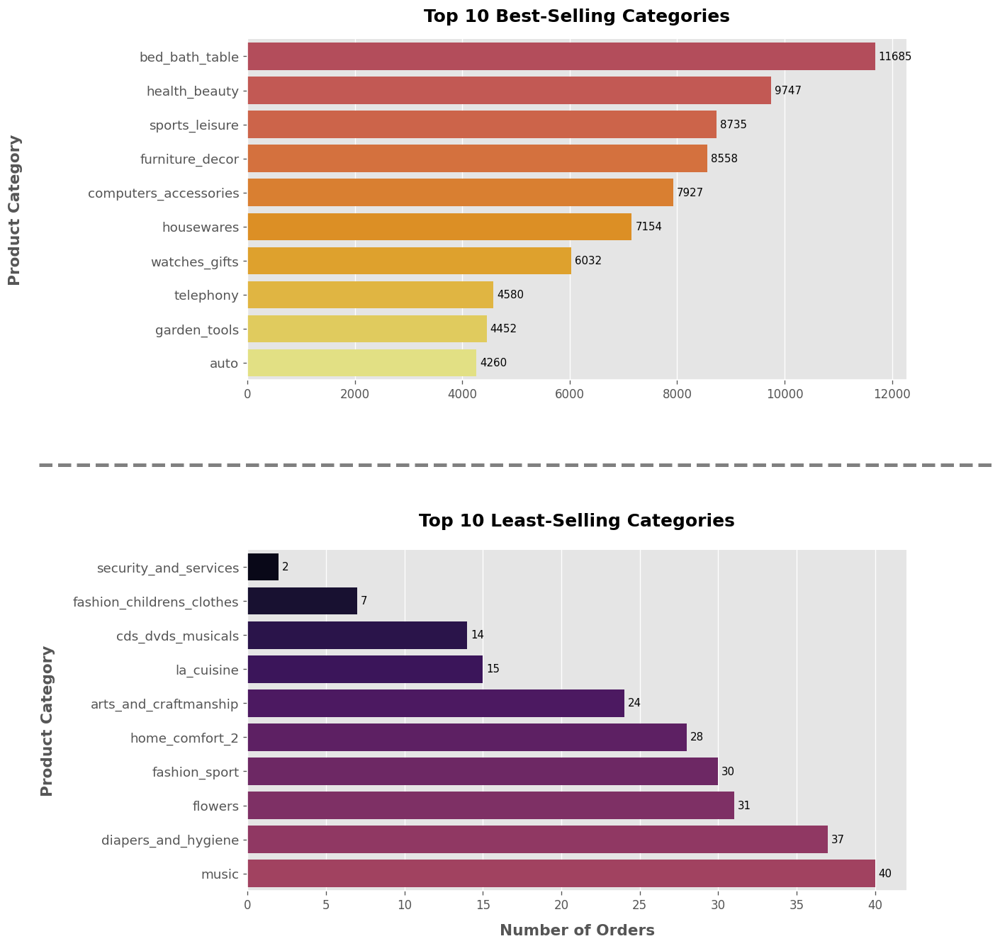

In [53]:
top_sales = delivered['product_category_name_english_x'].value_counts().nlargest(10)
tail_sales = delivered['product_category_name_english_x'].value_counts().nsmallest(10)

plot_pair(
    top_sales,
    tail_sales,
    'Top 10 Best-Selling Categories',
    'Top 10 Least-Selling Categories',
    xlabel='Number of Orders',
    ylabel='Product Category'
)

<ipython-input-51-e08f87e82043>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-51-e08f87e82043>:22: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




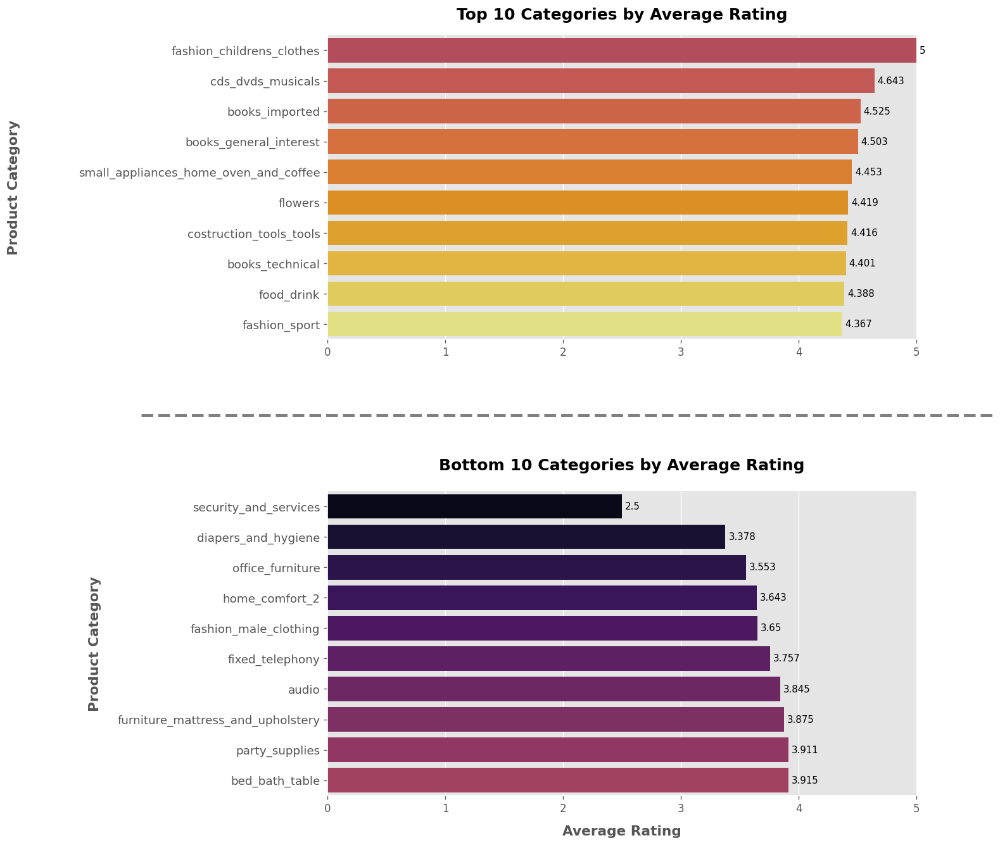

In [54]:
average_rating_top = delivered.groupby('product_category_name_english_x')['review_score'].mean().round(3).nlargest(10)
average_rating_tail = delivered.groupby('product_category_name_english_x')['review_score'].mean().round(3).nsmallest(10)

plot_pair(
    average_rating_top,
    average_rating_tail,
    'Top 10 Categories by Average Rating',
    'Bottom 10 Categories by Average Rating',
    xlabel='Average Rating',
    ylabel='Product Category',
    xlim_top=(0, 5),
    xlim_bot=(0, 5)
)

<ipython-input-51-e08f87e82043>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-51-e08f87e82043>:22: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




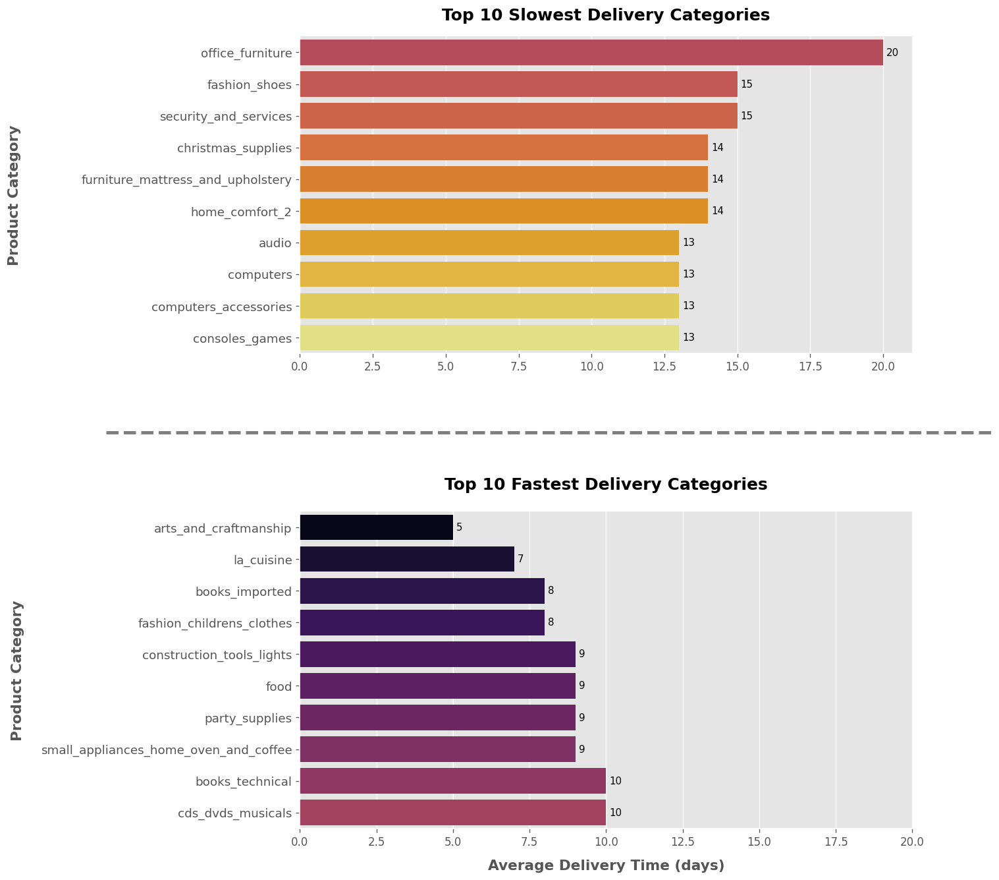

In [55]:
mean_deliv_time_top = delivered.groupby('product_category_name_english_x')['delivery_days'].mean().round().fillna(0).astype('int64').nlargest(10)
mean_deliv_time_tail = delivered.groupby('product_category_name_english_x')['delivery_days'].mean().round().fillna(0).astype('int64').nsmallest(10)

plot_pair(
    mean_deliv_time_top,
    mean_deliv_time_tail,
    'Top 10 Slowest Delivery Categories',
    'Top 10 Fastest Delivery Categories',
    xlabel='Average Delivery Time (days)',
    ylabel='Product Category',
    xlim_bot=(0,20)
)

<ipython-input-51-e08f87e82043>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-51-e08f87e82043>:22: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




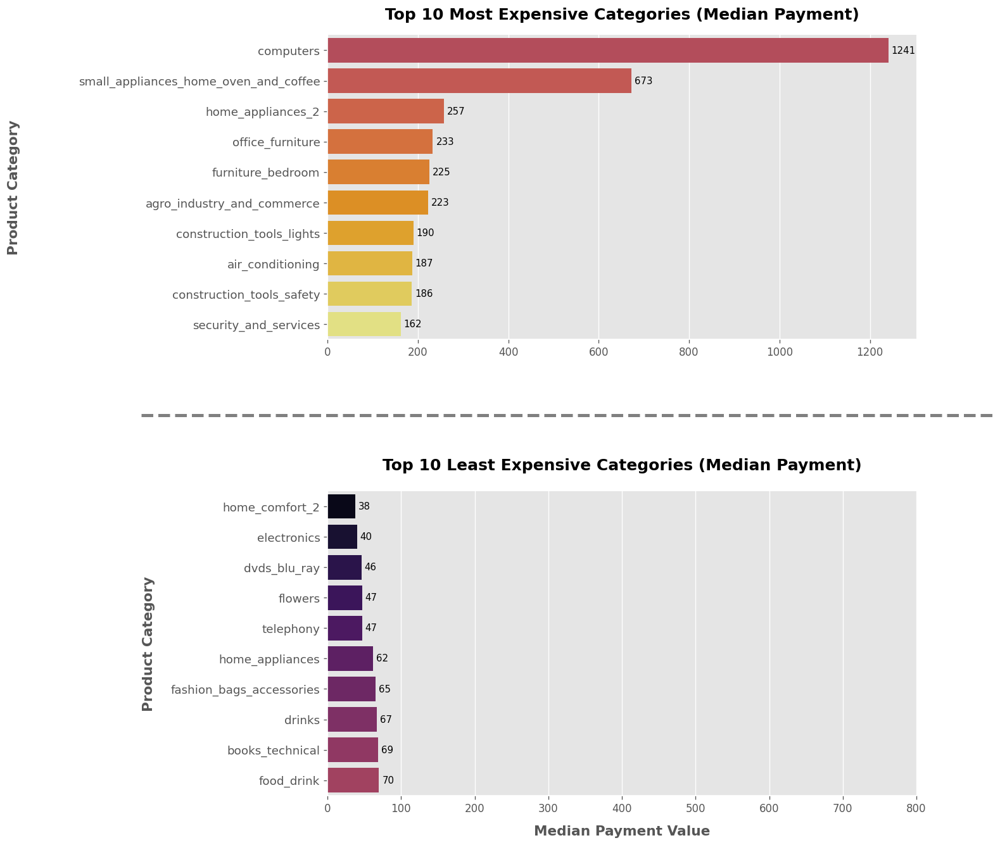

In [56]:
mean_payment_top = delivered.groupby('product_category_name_english_x')['payment_value'].median().round().astype('int64').nlargest(10)
mean_payment_tail = delivered.groupby('product_category_name_english_x')['payment_value'].median().round().astype('int64').nsmallest(10)

plot_pair(
    mean_payment_top,
    mean_payment_tail,
    'Top 10 Most Expensive Categories (Median Payment)',
    'Top 10 Least Expensive Categories (Median Payment)',
    xlabel='Median Payment Value',
    ylabel='Product Category',
    xlim_bot=(0, 800)
)

<ipython-input-28-96190cd63882>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




Text(0.5, 0, 'Review Score')

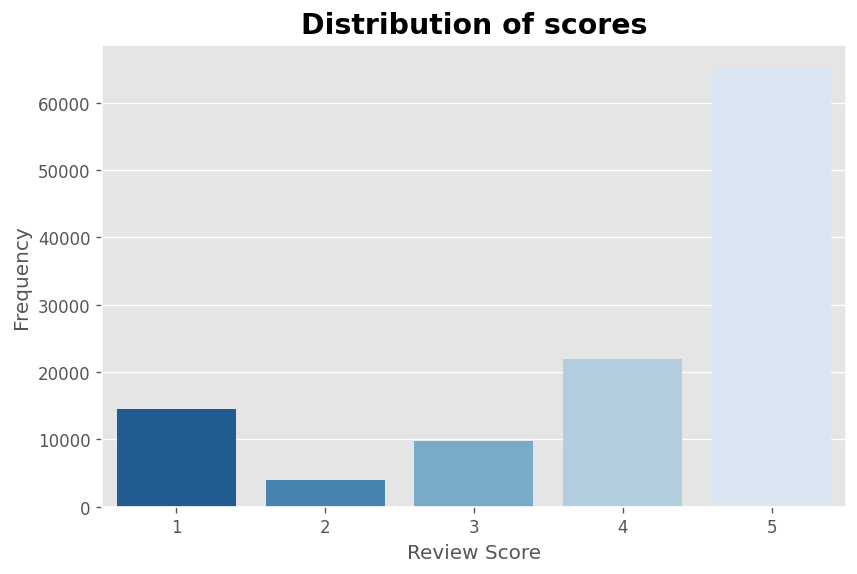

In [28]:
plt.figure(figsize=(8,5), dpi=120)
sns.countplot(x=df['review_score'], palette='Blues_r')
plt.title('Distribution of scores', fontsize=17, fontweight='bold', pad=7);
plt.ylabel('Frequency')
plt.xlabel('Review Score')

In [29]:
total_rev = df.groupby('review_score')['review_id'].count()
miss_rev = df[df['review_comment_message'].isnull()].groupby('review_score')['review_id'].count()

res = 100 - (miss_rev / total_rev).fillna(0)*100

<ipython-input-30-c16c87b371bc>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




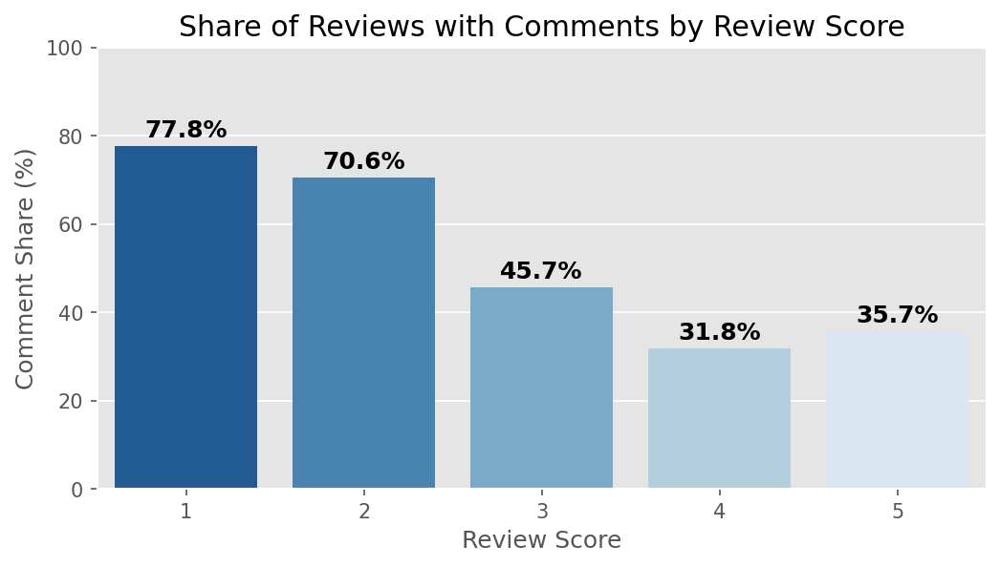

In [30]:
fig = plt.figure(figsize=(8,4), dpi=150)
ax = sns.barplot(x=res.index, y=res.values, palette='Blues_r')

for i, v in enumerate(res.values):
    ax.text(i, v + 2, f"{v:.1f}%", ha='center', fontsize=12, fontweight='bold')

plt.title("Share of Reviews with Comments by Review Score")
plt.xlabel("Review Score")
plt.ylabel("Comment Share (%)")
plt.ylim(0, 100);

In [31]:
# Filter for reviews with scores 1 or 2
negative_reviews = df[df['review_score'].isin([1, 2])]

# Combine all negative comments into a single string
negative_comments_df = ' '.join(negative_reviews['review_comment_message'].dropna().astype(str).tolist())

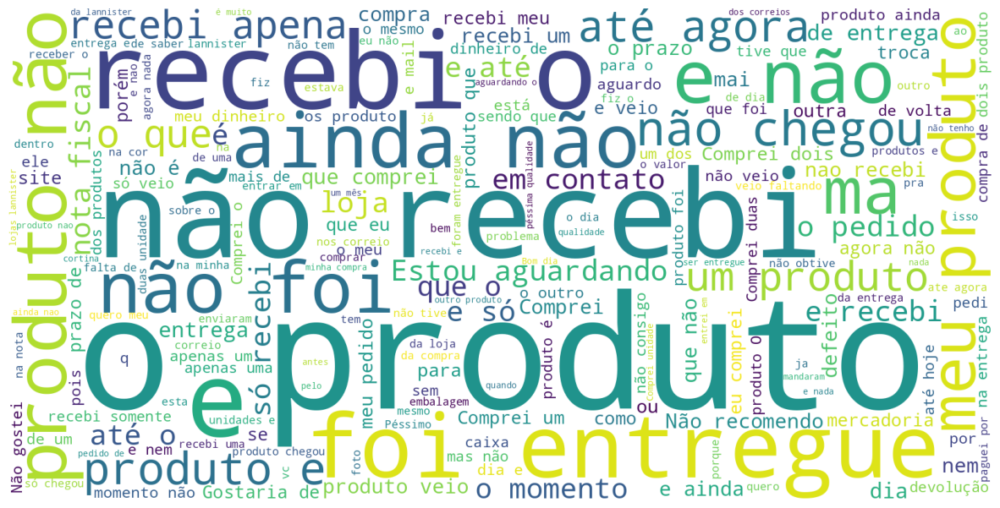

In [32]:
from wordcloud import WordCloud

wordcloud = WordCloud(width=1600, height=800, background_color='white').generate(negative_comments_df)
plt.figure(figsize=(15, 8))
plt.imshow(wordcloud)
plt.axis("off")
plt.show()

In [33]:
df['delivery_days'] = (df['order_delivered_customer_date'] - df['order_purchase_timestamp']).dt.days
df['delivery_delay'] = (df['order_delivered_customer_date'] - df['order_estimated_delivery_date']).dt.days

In [34]:
df['delivery_days'].value_counts().sort_values(ascending=False).head()

,count
delivery_days,
7.0,8965
6.0,8009
8.0,7957
9.0,7159
10.0,7000


<ipython-input-35-04b26c369943>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-35-04b26c369943>:3: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



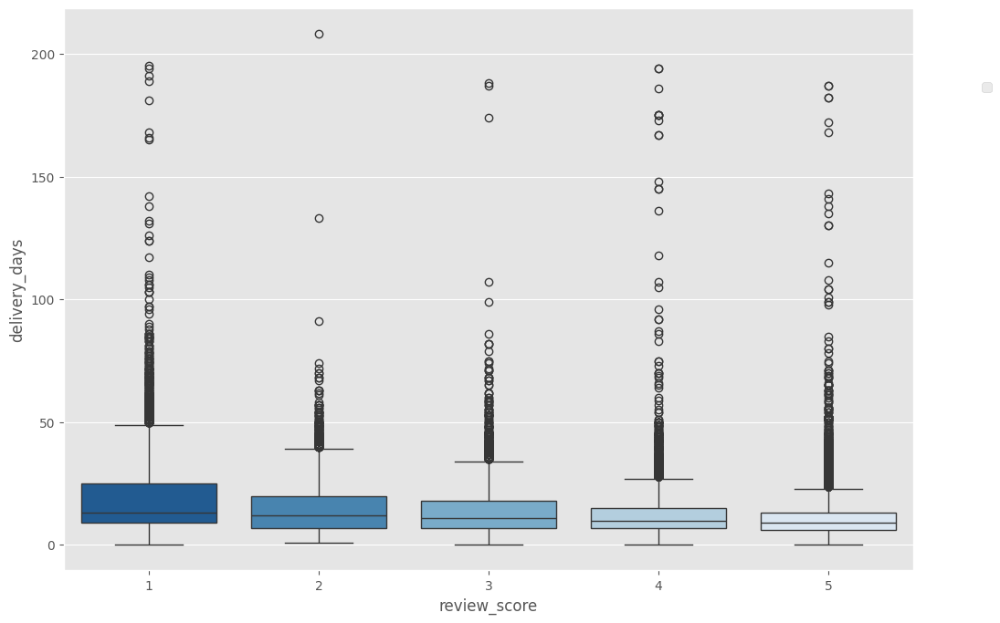

In [35]:
plt.figure(figsize=(12,8))
sns.boxplot(x=df['review_score'], y=df['delivery_days'], palette='Blues_r')
plt.legend(bbox_to_anchor=(1.1, 0.88))

<ipython-input-36-3f2c380f93a5>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


<ipython-input-36-3f2c380f93a5>:3: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



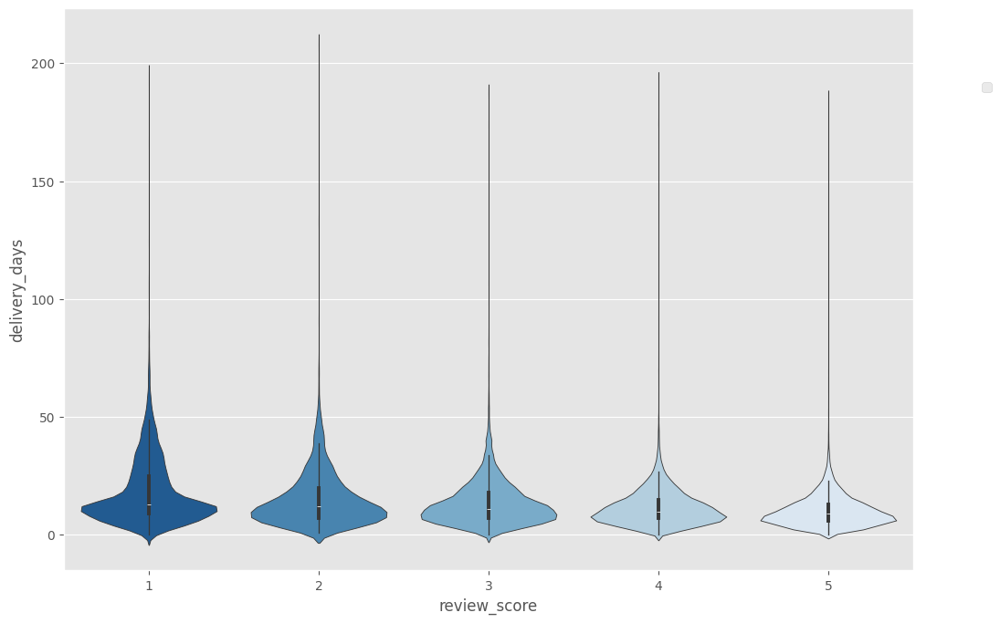

In [36]:
plt.figure(figsize=(12,8))
sns.violinplot (x=df['review_score'], y=df['delivery_days'], palette='Blues_r')
plt.legend( bbox_to_anchor=(1.1, 0.88));

In [37]:
df.groupby('review_score')['delivery_days'].median()

,delivery_days
review_score,
1,13.0
2,12.0
3,11.0
4,10.0
5,9.0


In [38]:
aggregated = df.groupby('seller_id').agg(
    avg_review_score=('review_score', 'mean'),
    total_sales=('price', 'sum'),
    num_orders=('order_id', 'count')
).reset_index()

df10 = aggregated[aggregated['num_orders'] > 10]
df10

,seller_id,avg_review_score,total_sales,num_orders
1,001cca7ae9ae17fb1caed9dfb1094831,3.911765,24938.93,238
3,002100f778ceb8431b7a1020ff7ab48f,4.033898,1303.10,59
4,004c9cd9d87a3c30c522c48c4fc07416,4.149701,19060.04,167
5,00720abe85ba0859807595bbf045a33b,3.653846,1007.50,26
8,00ee68308b45bc5e2660cd833c3f81cc,4.292553,21821.00,188
...,...,...,...,...
3022,ffc470761de7d0232558ba5e786e57b7,4.281250,1640.03,32
3024,ffdd9f82b9a447f6f8d4b91554cc7dd3,4.285714,2140.80,21
3025,ffeee66ac5d5a62fe688b9d26f83f534,4.214286,1839.86,14
3026,fffd5413c0700ac820c7069d66d98c89,3.819672,9169.50,61


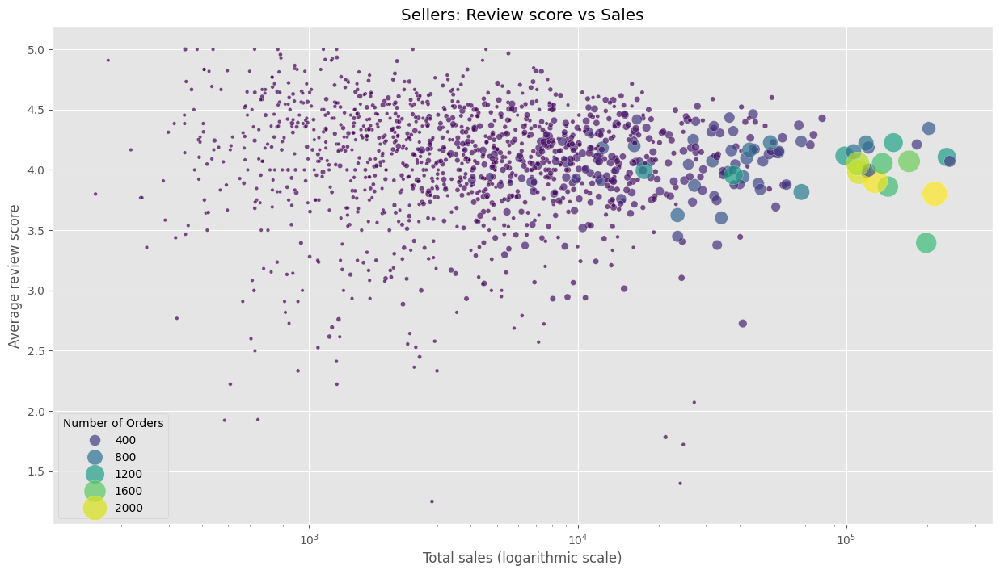

In [39]:
plt.figure(figsize=(15, 8))
sns.scatterplot(data=df10, x='total_sales', y='avg_review_score', size='num_orders', sizes=(10, 500),
                hue='num_orders', palette='viridis', alpha=0.7)
plt.xscale('log')
plt.xlabel('Total sales (logarithmic scale)')
plt.ylabel('Average review score')
plt.title('Sellers: Review score vs Sales')
plt.legend(title='Number of Orders')
plt.show()

PREPARE THE DATA

In [40]:
rfm_df = pd.read_csv('/content/drive/MyDrive/archive/bq-results-20250425-092511-1745573121501.csv')

In [41]:
print(rfm_df)

              RFM_Bucket  avg_days_since_purchase  avg_sales_per_customer  \
0           Recent Users                95.549684              114.419798   
1        Needs Attention               270.025409              124.405657   
2         About to Sleep               267.261092               40.424457   
3        Loyal Customers               260.816137              308.715866   
4              Promising               183.060763               26.611921   
5              Champions                96.339223              134.019655   
6   Potentital Loyalists               168.285187              214.775832   
7            Hibernating               445.504140              126.183694   
8        Can't Lose Them               523.335292              379.216181   
9        Price Sensitive                93.537838               39.550743   
10                  Lost               368.784469               28.069912   

    customer_count  
0             7286  
1             7517  
2           

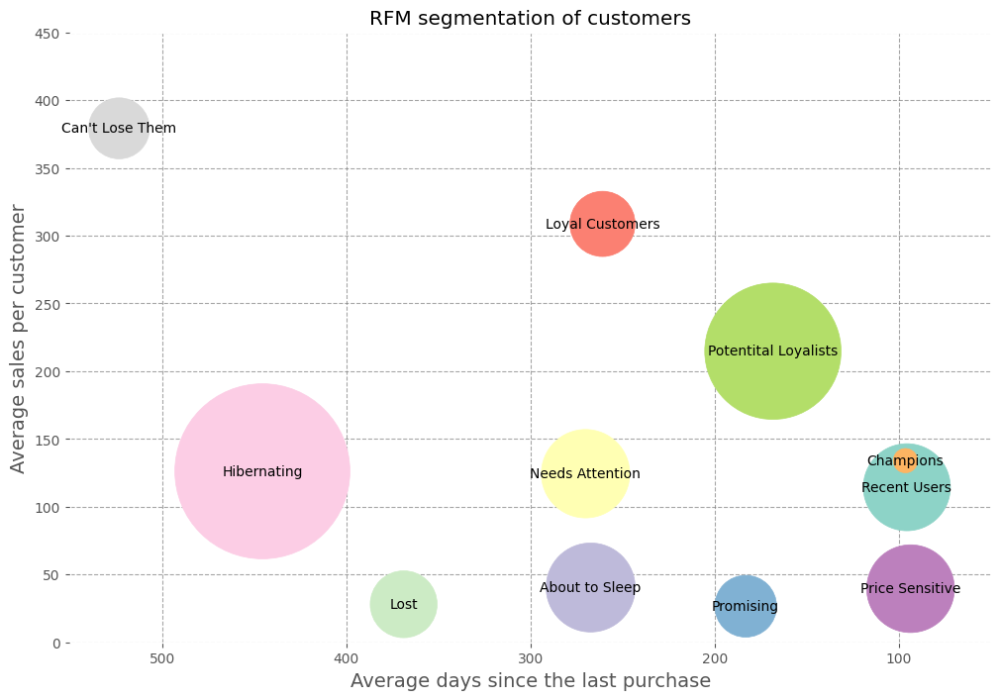

In [42]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor('white')
scatter = plt.scatter(rfm_df['avg_days_since_purchase'], rfm_df['avg_sales_per_customer'],
    s=rfm_df['customer_count']*0.55, c=sns.color_palette('Set3', len(rfm_df)))
plt.xlabel('Average days since the last purchase', fontsize=14)
plt.ylabel('Average sales per customer', fontsize=14)
plt.title('RFM segmentation of customers')
plt.grid(True)
for i, text in enumerate(rfm_df['RFM_Bucket']):
    plt.annotate(text, (rfm_df['avg_days_since_purchase'][i], rfm_df['avg_sales_per_customer'][i]),
        ha='center', va='center')
plt.gca().invert_xaxis()
plt.grid(True, linestyle='--', alpha=0.7, color = 'gray')
plt.xlim(550, 50)
plt.ylim(0, 450)
plt.show()

In [43]:
# Calculate customer purchase frequency
customer_orders = df.groupby('customer_unique_id')['order_id'].nunique().reset_index()
customer_orders['customer_type'] = customer_orders['order_id'].apply(lambda x: 'repeat' if x > 1 else 'one-time')

# Calculate proportions
df['proportions'] = customer_orders['customer_type'].value_counts(normalize=True) * 100

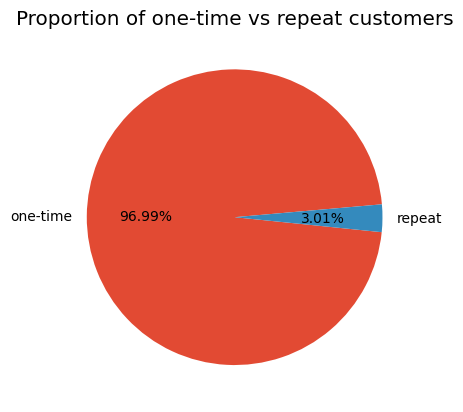

In [44]:
# Calculate customer purchase frequency
customer_orders = df.groupby('customer_unique_id')['order_id'].nunique().reset_index()
customer_orders['customer_type'] = customer_orders['order_id'].apply(lambda x: 'repeat' if x > 1 else 'one-time')

# Calculate proportions
proportions= customer_orders['customer_type'].value_counts(normalize=True) * 100

fig, ax = plt.subplots()
ax.pie(proportions, labels = proportions.index, startangle=5,autopct='%1.2f%%')
ax.set_title('Proportion of one-time vs repeat customers')
fig.set_facecolor('white')
plt.show()

In [45]:
name = pd.read_csv('/content/drive/MyDrive/archive/product_category_name_translation.csv')
name.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [46]:
df = df.merge(name, on='product_category_name', how='inner')

In [57]:
df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'review_id', 'review_score',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'product_category_name_english_x', 'day_of_week_int',
       'hour', 'month', 'year', 'date', 'delivery_time',
       'geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'orde

In [58]:
df['approval_time'] = df['order_approved_at'] - df['order_purchase_timestamp']
df['waiting_time'] = df['order_delivered_carrier_date'] - df['order_approved_at']
df['shipping_time'] = df['order_delivered_customer_date'] - df['order_delivered_carrier_date']
df['total_time'] = df['order_delivered_customer_date'] - df['order_purchase_timestamp']
df['estimated_time'] = df['order_estimated_delivery_date'] - df['order_purchase_timestamp']

In [59]:
time_columns = ['approval_time', 'waiting_time', 'shipping_time', 'total_time', 'estimated_time']

for col in time_columns:
    negatives = df[df[col] < pd.Timedelta(0)]
    print(f'{col}: {len(negatives)} negative values')

approval_time: 0 negative values
waiting_time: 1218 negative values
shipping_time: 58 negative values
total_time: 0 negative values
estimated_time: 0 negative values


In [60]:
df = df[df['waiting_time'] >= pd.Timedelta(0)]
df = df[df['shipping_time'] >= pd.Timedelta(0)]

In [61]:
time_columns = ['approval_time', 'waiting_time', 'shipping_time', 'total_time', 'estimated_time']

summary = pd.DataFrame({
    'mean': df[time_columns].mean(),
    'median': df[time_columns].median(),
    'std': df[time_columns].std()
})

summary = summary.applymap(lambda x: pd.to_timedelta(x.round('s')))

summary

<ipython-input-61-f8cf4cca5fba>:9: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



,mean,median,std
approval_time,0 days 09:49:50,0 days 00:20:28,0 days 19:48:58
waiting_time,2 days 21:16:28,1 days 21:03:33,3 days 11:37:31
shipping_time,9 days 04:56:45,7 days 01:43:10,8 days 13:24:05
total_time,12 days 12:03:03,10 days 05:56:43,9 days 08:59:13
estimated_time,23 days 20:27:29,23 days 06:27:20,8 days 20:05:58


<ipython-input-62-641050966a1c>:18: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



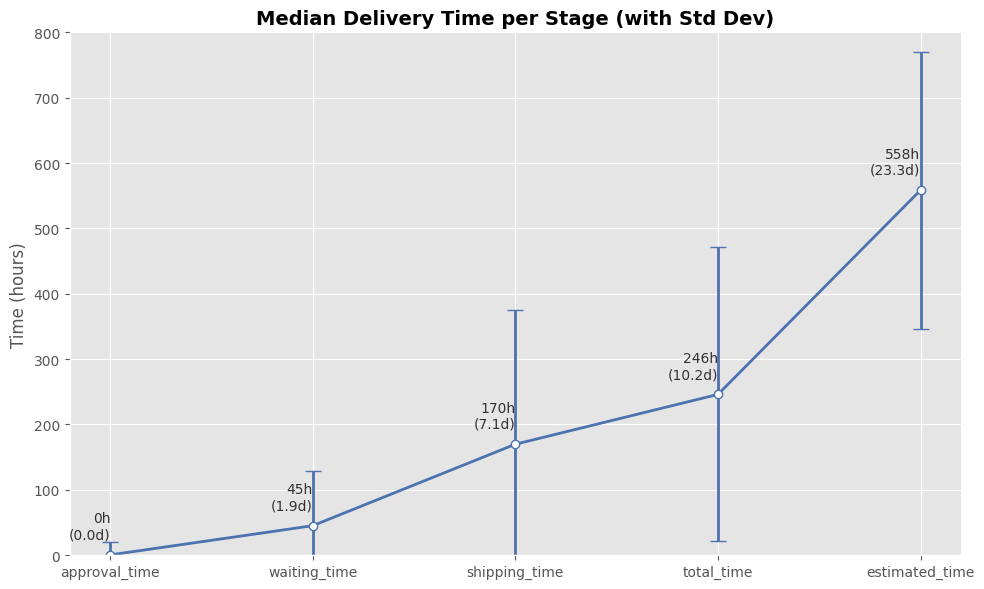

In [62]:
summary = pd.DataFrame({
    'median': [
        df['approval_time'].median(),
        df[df['waiting_time'].notna()]['waiting_time'].median(),
        df[df['shipping_time'].notna()]['shipping_time'].median(),
        df['total_time'].median(),
        df['estimated_time'].median()
    ],
    'std': [
        df['approval_time'].std(),
        df[df['waiting_time'].notna()]['waiting_time'].std(),
        df[df['shipping_time'].notna()]['shipping_time'].std(),
        df['total_time'].std(),
        df['estimated_time'].std()
    ]
}, index=['approval_time', 'waiting_time', 'shipping_time', 'total_time', 'estimated_time'])

summary = summary.applymap(lambda x: pd.to_timedelta(x.round('s')))

summary['median_hours'] = summary['median'].dt.total_seconds() / 3600
summary['std_hours'] = summary['std'].dt.total_seconds() / 3600
summary['label'] = summary['median_hours'].apply(lambda h: f"{h:.0f}h\n({h/24:.1f}d)")

plt.figure(figsize=(10, 6))
plt.errorbar(summary.index, summary['median_hours'], yerr=summary['std_hours'],
             fmt='-o', color='#4C72B0', capsize=6, lw=2, markerfacecolor='white')

for i, (x, y) in enumerate(zip(summary.index, summary['median_hours'])):
    plt.text(x, y + 25, summary['label'].iloc[i], ha='right', fontsize=10, color='#333')

plt.title('Median Delivery Time per Stage (with Std Dev)', fontsize=14, weight='bold')
plt.ylabel('Time (hours)', fontsize=12)
plt.ylim(0, 800)
plt.grid(True)
plt.tight_layout()

for spine in ['top', 'right']:
    plt.gca().spines[spine].set_visible(False)

plt.show()

<ipython-input-63-f7fb1cee4be1>:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




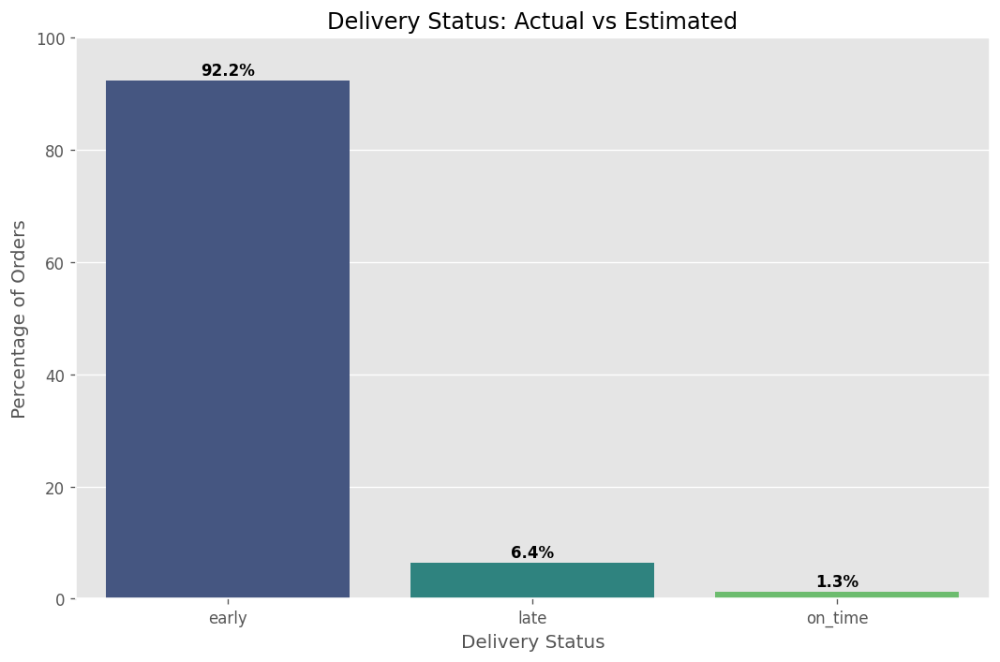

In [63]:
def delivery_status(row):
    if pd.isna(row["delivery_delay"]):
        return "missing"
    if row["delivery_delay"] < 0:
        return "early"
    elif row["delivery_delay"] > 0:
        return "late"
    else:
        return "on_time"

df["delivery_status"] = df.apply(delivery_status, axis=1)


status_counts = df["delivery_status"].value_counts(normalize=True).drop("missing", errors='ignore') * 100


plt.figure(figsize=(9, 6),dpi=120)
ax = sns.barplot(x=status_counts.index, y=status_counts.values, palette="viridis")

for i, val in enumerate(status_counts.values):
    ax.text(i, val + 1, f"{val:.1f}%", ha="center", fontweight="bold")

plt.title("Delivery Status: Actual vs Estimated")
plt.ylabel("Percentage of Orders")
plt.xlabel("Delivery Status")
plt.ylim(0, 100)
plt.tight_layout()
plt.show()

In [64]:
df['delivery_status'].value_counts()

,count
delivery_status,
early,81113
late,5671
on_time,1145


In [65]:
df[df['delivery_status'] == 'late']['review_score'].value_counts(normalize=True)

,proportion
review_score,
1,0.551049
5,0.164874
3,0.103685
4,0.096103
2,0.084288


In [66]:
df[df['delivery_status'] == 'early']['review_score'].value_counts(normalize=True)

,proportion
review_score,
5,0.602246
4,0.200732
1,0.083612
3,0.083106
2,0.030303


<Figure size 1960x1400 with 0 Axes>

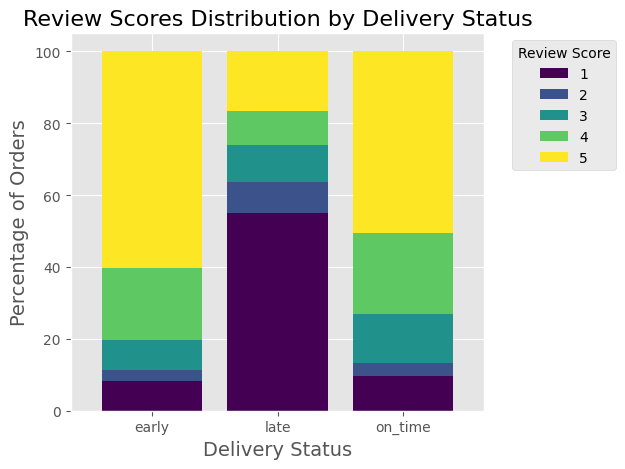

In [67]:
stacked_data = df.groupby(['delivery_status', 'review_score']).size().unstack().fillna(0)
stacked_data = stacked_data.div(stacked_data.sum(axis=1), axis=0) * 100

plt.figure(figsize=(14, 10), dpi=140)
stacked_data.plot(kind='bar', stacked=True, cmap='viridis', width=0.8)

plt.title("Review Scores Distribution by Delivery Status", fontsize=16)
plt.xlabel("Delivery Status", fontsize=14)
plt.ylabel("Percentage of Orders", fontsize=14)
plt.xticks(rotation=0)
plt.legend(title="Review Score", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout();

In [68]:
early = df[df['delivery_status'] == 'early']['review_score'].dropna()
late = df[df['delivery_status'] == 'late']['review_score'].dropna()

stat, p = mannwhitneyu(early, late, alternative='two-sided')
print(f"U-statistic: {stat:.2f}, p-value: {p:.10f}")

U-statistic: 372000946.00, p-value: 0.0000000000


<ipython-input-69-7492094b5c13>:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




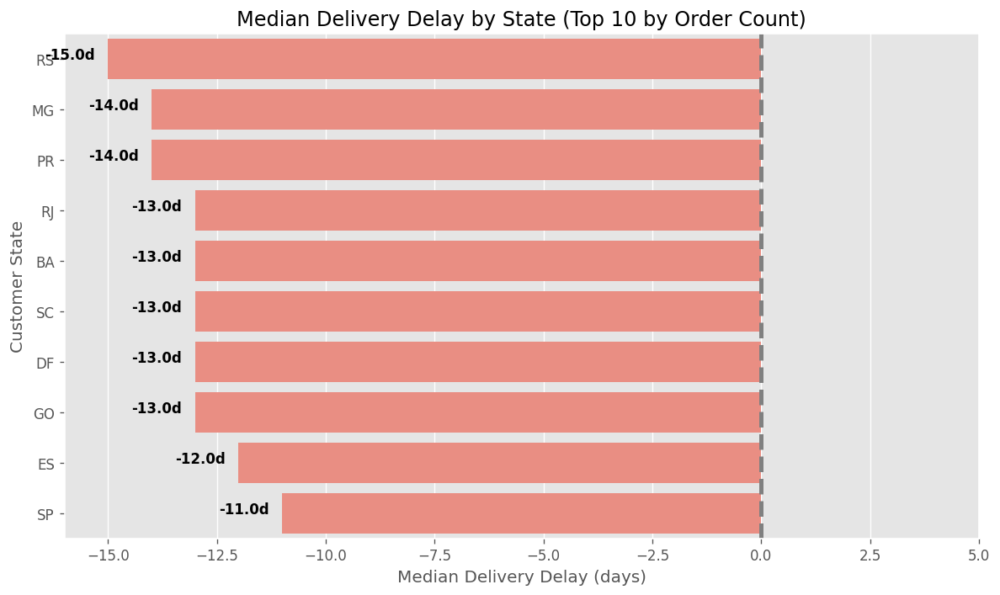

In [69]:
delay = df.groupby('customer_state')['delivery_delay'].agg(['median', 'count'])
top_states = delay.sort_values('count', ascending=False).head(10).sort_values('median')

plt.figure(figsize=(10, 6), dpi=120)

palette = ['salmon' if val < 0 else 'springgreen' for val in top_states['median']]
ax = sns.barplot(
    x='median',
    y=top_states.index,
    data=top_states,
    palette=palette
)

plt.axvline(0, color='gray', linestyle='--', linewidth=3)

x_min = top_states['median'].min() - 1
plt.xlim(x_min, 5)

for i, val in enumerate(top_states['median']):
    ax.text(val + (0.3 if val >= 0 else -0.3), i, f"{val:.1f}d",
            color='black', ha='left' if val >= 0 else 'right', fontweight='bold')

plt.title("Median Delivery Delay by State (Top 10 by Order Count)")
plt.xlabel("Median Delivery Delay (days)")
plt.ylabel("Customer State")
plt.tight_layout();

In [70]:
avg_freight_value = df.groupby(df['order_purchase_timestamp'].dt.to_period('M'))['freight_value'].agg('sum').reset_index()
avg_freight_value

,order_purchase_timestamp,freight_value
0,2016-10,4477.89
1,2017-01,12995.11
2,2017-02,29903.48
3,2017-03,44791.71
4,2017-04,39552.28
5,2017-05,63843.06
6,2017-06,55854.47
7,2017-07,71572.18
8,2017-08,73646.07
9,2017-09,76159.44


In [71]:
avg_fr_val = []

for i in range(len(avg_freight_value)):
    current_period = avg_freight_value.loc[i,'order_purchase_timestamp']
    filter_df = df[df['order_purchase_timestamp'].dt.to_period('M') == current_period]
    avg_fr_val.append(np.ceil(filter_df['freight_value'].mean()))

In [72]:
avg_freight_value['avg_freight_value'] = avg_fr_val
avg_freight_value

,order_purchase_timestamp,freight_value,avg_freight_value
0,2016-10,4477.89,19.0
1,2017-01,12995.11,18.0
2,2017-02,29903.48,20.0
3,2017-03,44791.71,19.0
4,2017-04,39552.28,20.0
5,2017-05,63843.06,20.0
6,2017-06,55854.47,20.0
7,2017-07,71572.18,20.0
8,2017-08,73646.07,20.0
9,2017-09,76159.44,20.0


<ipython-input-73-b08f6e4d47f6>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




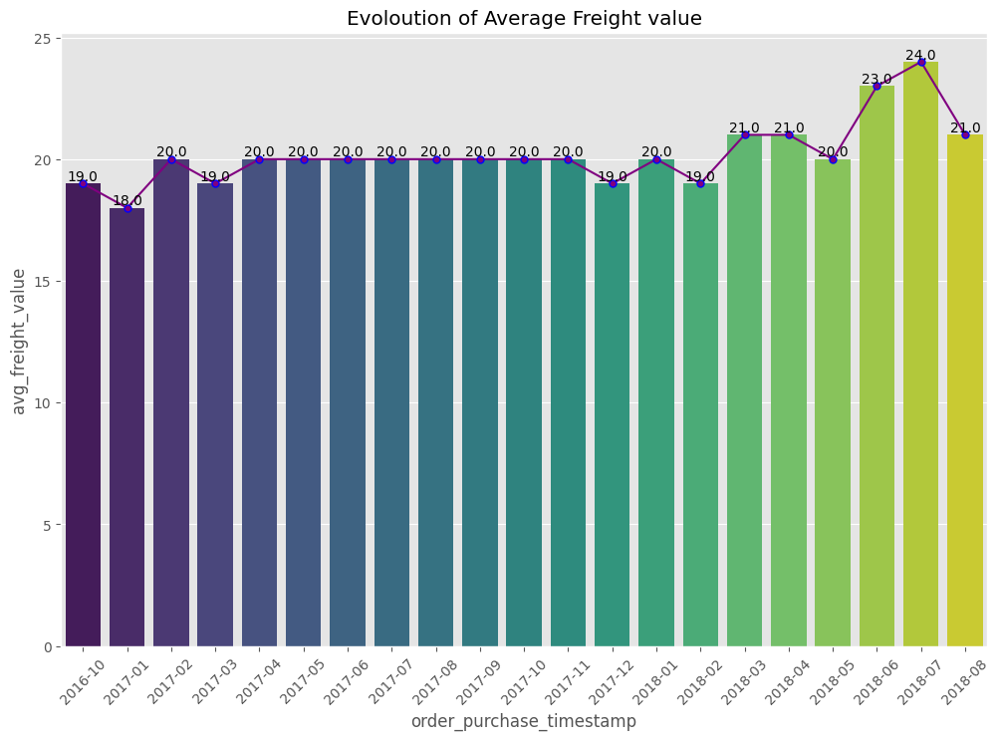

In [73]:
x = avg_freight_value['order_purchase_timestamp'].astype(str)
y = avg_freight_value['avg_freight_value']
plt.figure(figsize=(12,8))
plt.plot(x,y,marker='.', color='purple',markersize=10, markeredgecolor = 'blue')
ax = sns.barplot(x=x, y=y, palette='viridis')
plt.xticks(rotation=45)
plt.title("Evoloution of Average Freight value")
c = 0
for p in ax.patches:
        x=p.get_bbox().get_points()[:,0]
        y=p.get_bbox().get_points()[1,1]
        ax.annotate('{:}'.format(avg_freight_value['avg_freight_value'][c]), (x.mean(), y),
                ha='center', va='bottom') # set the alignment of the text
        c+=1
plt.show()

In [74]:
state_price = df.groupby('customer_state')['price'].agg('mean').sort_values(ascending=False).reset_index()
state_price

,customer_state,price
0,PB,201.926682
1,AL,183.821224
2,AC,182.091600
3,TO,168.132243
4,RO,167.942035
5,RN,166.510238
6,PI,163.496988
7,CE,158.615520
8,RR,157.254412
9,PA,154.609096


<ipython-input-75-ef14eb200e3e>:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




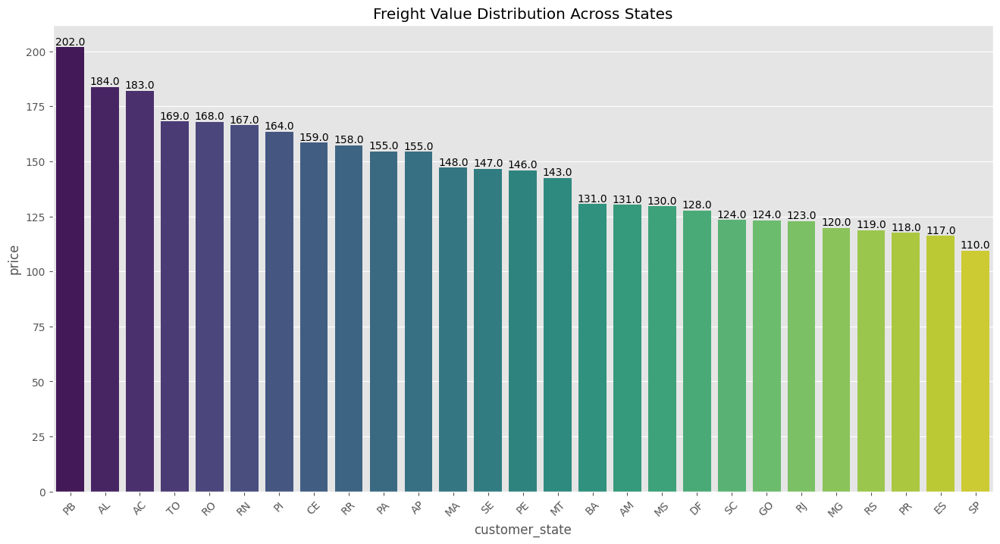

In [75]:
x = state_price['customer_state']
y = state_price['price']
plt.figure(figsize=(16,8))
ax = sns.barplot(x=x, y=y, palette='viridis')
plt.xticks(rotation=45)
plt.title("Freight Value Distribution Across States")
c = 0
for p in ax.patches:
        x=p.get_bbox().get_points()[:,0]
        y=p.get_bbox().get_points()[1,1]
        ax.annotate('{:}'.format(np.ceil(state_price['price'][c])), (x.mean(), y),
                ha='center', va='bottom')
        c+=1
plt.show()

In [76]:
customer_data = df.groupby('customer_unique_id').agg(
    zip_code_prefix=('customer_zip_code_prefix', 'first'),
    order_count=('order_id', pd.Series.nunique),
    total_payment=('payment_value', 'sum'),
    first_order_day=('order_purchase_timestamp', 'min'),
    last_order_day=('order_purchase_timestamp', 'max')
).reset_index()

# Calculate derived metrics
customer_data['PF'] = customer_data['order_count']
customer_data['AOV'] = customer_data['total_payment'] / customer_data['order_count']
days_active = (customer_data['last_order_day'] - customer_data['first_order_day']).dt.days
customer_data['ACL'] = days_active.apply(lambda x: 1 if x < 7 else x / 7)

# Select relevant columns
result = customer_data[['customer_unique_id', 'zip_code_prefix', 'PF', 'AOV', 'ACL']]

print(result.head())

                 customer_unique_id  zip_code_prefix  PF     AOV  ACL
0  0000366f3b9a7992bf8c76cfdf3221e2             7787   1  141.90  1.0
1  0000b849f77a49e4a4ce2b2a4ca5be3f             6053   1   27.19  1.0
2  0000f46a3911fa3c0805444483337064            88115   1   86.22  1.0
3  0000f6ccb0745a6a4b88665a16c9f078            66812   1   43.62  1.0
4  0004aac84e0df4da2b147fca70cf8255            18040   1  196.89  1.0


In [77]:
# Group by zip_code prefix to compute average CLV and customer count
zip_agg = result.groupby('zip_code_prefix').agg(
    avg_CLV=('PF', lambda x: (x * result.loc[x.index, 'AOV'] * result.loc[x.index, 'ACL']).mean()),
    customer_count=('customer_unique_id', 'count')
).reset_index()

# Merge with geolocation data
zip_agg = zip_agg.merge(
    df,
    left_on='zip_code_prefix',
    right_on='geolocation_zip_code_prefix',
    how='left'
)

# Drop duplicate zip_prefix rows, keeping the first occurrence
zip_agg = zip_agg.drop_duplicates(subset=['zip_code_prefix'], keep='first')

# Optionally select/rename relevant columns
zip_agg = zip_agg.rename(columns={
    'geolocation_lat': 'latitude',
    'geolocation_lng': 'longitude',
    'zip_code_prefix': 'zip_prefix'
})[['zip_prefix', 'avg_CLV', 'customer_count', 'latitude', 'longitude']]

print(zip_agg.head())

    zip_prefix     avg_CLV  customer_count   latitude  longitude
0         1004   91.160000               1 -23.549829 -46.634792
1         1005   68.260000               4 -23.549547 -46.636406
5         1006  434.025000               2 -23.550127 -46.636044
7         1007  126.387500               4 -23.549962 -46.637204
11        1008  122.886667               3 -23.546000 -46.635877


In [78]:
import folium
# Filter out rows with NaN values in latitude or longitude
zip_agg_filtered = zip_agg.dropna(subset=['latitude', 'longitude'])
map = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)
for i, zip_prefix in zip_agg_filtered.iterrows():
    folium.CircleMarker(
        location=[zip_prefix['latitude'], zip_prefix['longitude']],
        radius=0.1*np.sqrt(zip_prefix['customer_count']),
        color=None,
        fill_color='#85001d',
        fill_opacity=0.1+0.1*np.sqrt(zip_prefix['avg_CLV']/zip_agg['avg_CLV'].max()),
        popup=(
            f"<b>Zip Code Prefix:</b> {int(zip_prefix['zip_prefix'])}<br>"
            f"<b>Average CLV:</b> {int(zip_prefix['avg_CLV'])}<br>"
            f"<b>Customers:</b> {int(zip_prefix['customer_count'])}"
        )
    ).add_to(map)
map